In [1]:
# !pip install openmim
# !mim install mmdet

import torch
import mmcv
import mmdet

/home/cine/miniconda3/envs/mmlab1/lib/python3.8/site-packages/mmcv/__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(


In [2]:
print(torch.__version__,mmcv.__version__,mmdet.__version__)

1.6.0 1.7.1 2.28.0


In [4]:
# download the pretrained model with smallest size
!mim download mmdet --config mask_rcnn_r50_fpn_2x_coco --dest .

processing mask_rcnn_r50_fpn_2x_coco...
mask_rcnn_r50_fpn_2x_coco_bbox_mAP-0.392__segm_mAP-0.354_20200505_003907-3e542a40.pth exists in /home/cine/mmdetection
Successfully dumped mask_rcnn_r50_fpn_2x_coco.py to /home/cine/mmdetection


In [4]:
# generate coco format json
!python balloon2CoCoFormat.py

/home/cine/miniconda3/envs/mmlab1/lib/python3.8/site-packages/mmcv/__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(
[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 61/61, 54.7 task/s, elapsed: 1s, ETA:     0s
[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 13/13, 54.3 task/s, elapsed: 0s, ETA:     0s


In [7]:
# Test model before retraining
from mmdet.apis import init_detector,inference_detector,show_result_pyplot
config_file = 'mask_rcnn_r50_fpn_2x_coco.py'
checkpoint_file = 'mask_rcnn_r50_fpn_2x_coco_bbox_mAP-0.392__segm_mAP-0.354_20200505_003907-3e542a40.pth'
model0 = init_detector(config_file,checkpoint_file)

load checkpoint from local path: mask_rcnn_r50_fpn_2x_coco_bbox_mAP-0.392__segm_mAP-0.354_20200505_003907-3e542a40.pth


/home/cine/mmdetection/mmdet/datasets/utils.py:66: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


([array([[2.9731760e+02, 2.7740814e+02, 8.1956726e+02, 7.6425647e+02,
        9.9797767e-01],
       [0.0000000e+00, 6.1942035e+02, 2.3369914e+02, 7.6339899e+02,
        8.8299662e-01],
       [1.7861410e+00, 4.0773123e+02, 2.2126079e+02, 7.5970404e+02,
        3.6979535e-01],
       [1.9583382e+01, 2.3842120e+02, 5.6991223e+02, 7.6579016e+02,
        1.4523299e-01]], dtype=float32), array([], shape=(0, 5), dtype=float32), array([], shape=(0, 5), dtype=float32), array([], shape=(0, 5), dtype=float32), array([], shape=(0, 5), dtype=float32), array([], shape=(0, 5), dtype=float32), array([], shape=(0, 5), dtype=float32), array([], shape=(0, 5), dtype=float32), array([], shape=(0, 5), dtype=float32), array([], shape=(0, 5), dtype=float32), array([], shape=(0, 5), dtype=float32), array([[6.6940509e+02, 1.7940675e+00, 9.1726300e+02, 2.4630986e+02,
        8.1139460e-02]], dtype=float32), array([], shape=(0, 5), dtype=float32), array([], shape=(0, 5), dtype=float32), array([], shape=(0, 5), 

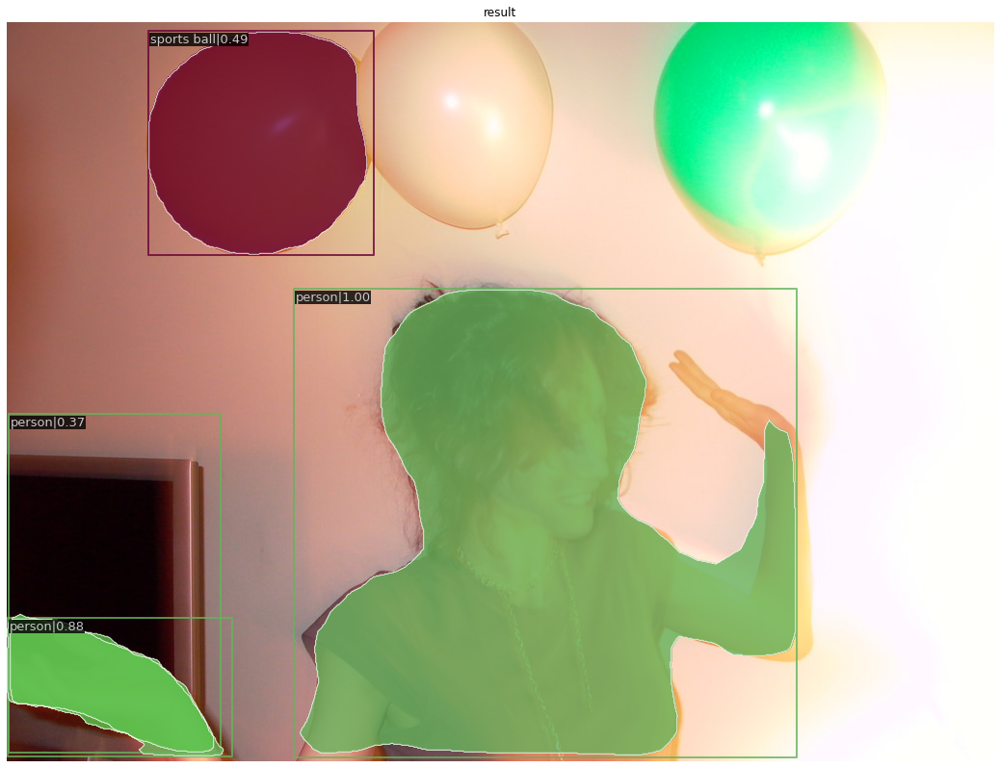

In [8]:
image_path = './data/balloon/val/410488422_5f8991f26e_b.jpg'
result = inference_detector(model0,image_path)
# print(result)
show_result_pyplot(model0,image_path,result)

In [24]:
!mim train mmdet mask_rcnn_r50_fpn_2x_coco_balloon.py
# Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /home/cine/.cache/torch/checkpoints/resnet50-19c8e357.pth
# 100.0%

# model = dict(
#     type='MaskRCNN',
#     backbone=dict(
#         type='ResNet',
#         depth=50,
#         num_stages=4,
#         out_indices=(0, 1, 2, 3),
#         frozen_stages=1,
#         norm_cfg=dict(type='BN', requires_grad=True),
#         norm_eval=True,
#         style='pytorch',
#         init_cfg=dict(type='Pretrained', checkpoint='torchvision://resnet50')),

/home/cine/miniconda3/envs/mmlab1/lib/python3.8/site-packages/mmcv/__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(
Training command is /home/cine/miniconda3/envs/mmlab1/bin/python /home/cine/mmdetection/mmdet/.mim/tools/train.py mask_rcnn_r50_fpn_2x_coco_balloon.py --launcher none --gpus 1. 
/home/cine/miniconda3/envs/mmlab1/lib/python3.8/site-packages/mmcv/__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob

In [10]:
# config_file = 'mask_rcnn_r50_fpn_2x_coco_balloon.py'
# model = init_detector(config_file,checkpoint_file)
# result = inference_detector(model,image_path)
# show_result_pyplot(model,image_path,result)
# # The model and loaded state dict do not match exactly
# #
# # size mismatch for roi_head.bbox_head.fc_cls.weight: copying a param with shape torch.Size([81, 1024]) from checkpoint, the shape in current model is torch.Size([2, 1024]).
# # size mismatch for roi_head.bbox_head.fc_cls.bias: copying a param with shape torch.Size([81]) from checkpoint, the shape in current model is torch.Size([2]).
# # size mismatch for roi_head.bbox_head.fc_reg.weight: copying a param with shape torch.Size([320, 1024]) from checkpoint, the shape in current model is torch.Size([4, 1024]).
# # size mismatch for roi_head.bbox_head.fc_reg.bias: copying a param with shape torch.Size([320]) from checkpoint, the shape in current model is torch.Size([4]).
# # size mismatch for roi_head.mask_head.conv_logits.weight: copying a param with shape torch.Size([80, 256, 1, 1]) from checkpoint, the shape in current model is torch.Size([1, 256, 1, 1]).
# # size mismatch for roi_head.mask_head.conv_logits.bias: copying a param with shape torch.Size([80]) from checkpoint, the shape in current model is torch.Size([1]).

load checkpoint from local path: work_dirs/mask_rcnn_r50_fpn_2x_coco_balloon/latest.pth


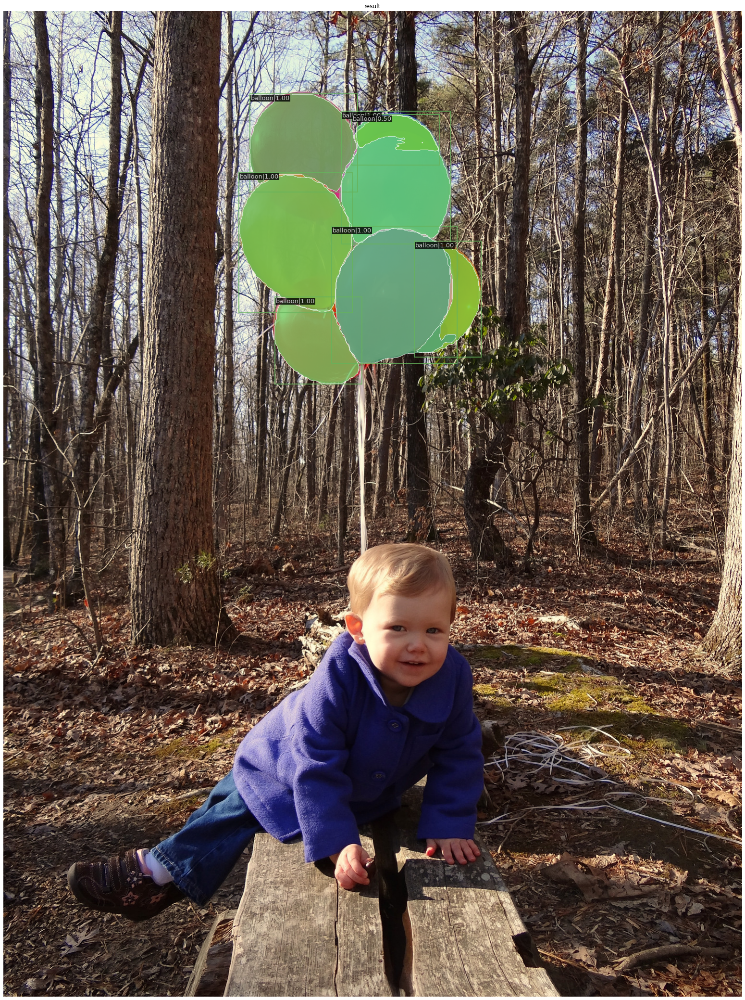

In [46]:
checkpoint_file_retrain = 'work_dirs/mask_rcnn_r50_fpn_2x_coco_balloon/latest.pth'
model = init_detector(config_file,checkpoint_file_retrain)
result_retrain = inference_detector(model,image_path)
show_result_pyplot(model,image_path,result_retrain)

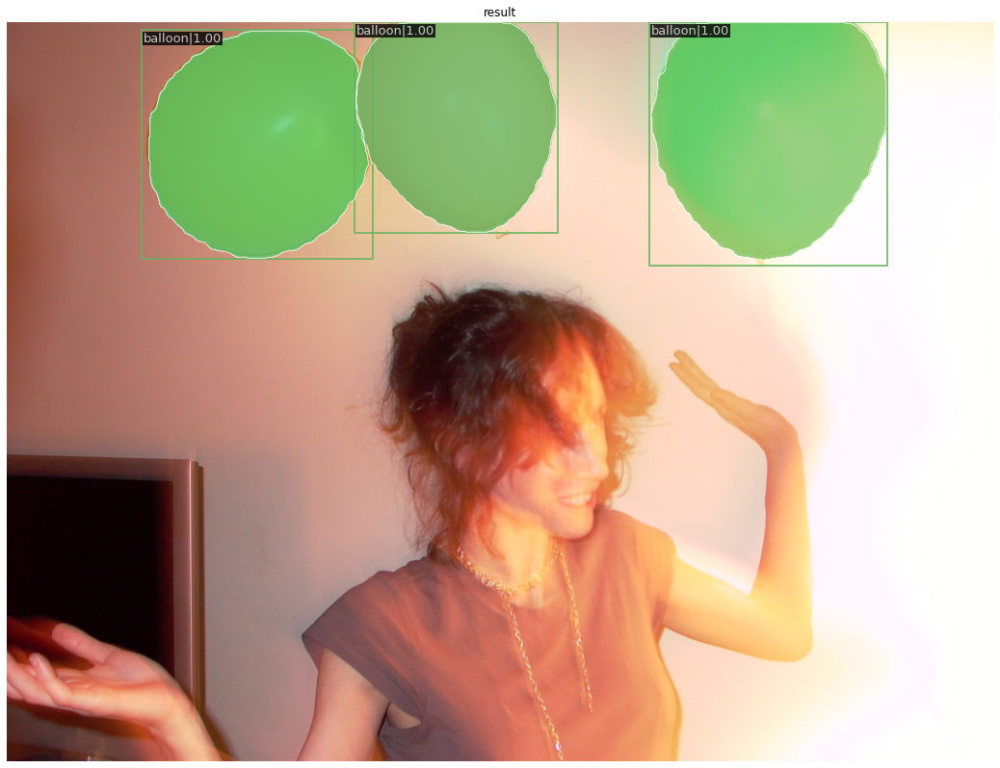

In [48]:
# image_path = 'data/balloon/val/16335852991_f55de7958d_k.jpg'
image_path = './data/balloon/val/410488422_5f8991f26e_b.jpg'
# model = init_detector(config_file,checkpoint_file_retrain)
result_retrain = inference_detector(model,image_path)
show_result_pyplot(model,image_path,result_retrain)

In [24]:
import numpy as np
# result_retrain_arr =np.array(result_retrain)


def showShape(input_):
    input_arr = np.array(input_)
    print(input_arr.shape)
    # print(input_arr)

# # result_retrain[0]
# # result_retrain[1]
for i in result_retrain:
    showShape(i)
# # (1, 3, 5)
# # (1, 3, 768, 1024)

# np.array(result_retrain[1]).shape   #　(1, 3, 768, 1024)  three channel mask
# result_retrain[0]
# mmcv.imread(image_path, channel_order='rgb').shape  # (768, 1024, 3)

result_retrain[0]  # box*4+score
# [array([[3.6045764e+02, 0.0000000e+00, 5.7187622e+02, 2.1934343e+02,
#          9.9945372e-01],
#         [6.6618005e+02, 1.6541016e-01, 9.1358221e+02, 2.5361465e+02,
#          9.9932182e-01],
#         [1.3965622e+02, 8.4932156e+00, 3.7981638e+02, 2.4632968e+02,
#          9.9929368e-01]], dtype=float32)]

(1, 3, 5)
(1, 3, 768, 1024)


[array([[3.6045764e+02, 0.0000000e+00, 5.7187622e+02, 2.1934343e+02,
         9.9945372e-01],
        [6.6618005e+02, 1.6541016e-01, 9.1358221e+02, 2.5361465e+02,
         9.9932182e-01],
        [1.3965622e+02, 8.4932156e+00, 3.7981638e+02, 2.4632968e+02,
         9.9929368e-01]], dtype=float32)]

In [23]:
# def parse_args():
#     parser = argparse.ArgumentParser(description='MMDetection balloon color splash video demo')
#     parser.add_argument('video_path', help='path of video file ')
#     parser.add_argument('model_config', help='path of config file ')
#     parser.add_argument('checkpoint_path', help='path of fine-tuned checkpoint file')
#     parser.add_argument(
#         '--device', default='cuda:0', help='Device used for inference')
#     parser.add_argument(
#         '--score_thr', type=float, default=0.8, help='Bbox score threshold')
#     parser.add_argument('--output_path', type=str, help='path of processed video file')
#     parser.add_argument('--display_video', action='store_true', help='display the processed video')
#     parser.add_argument(
#         '--wait-time',
#         type=float,
#         default=1,
#         help='The interval of display (s), 0 is block, default is 1')
#     args = parser.parse_args()
#     return args

(768, 1024, 3)

In [49]:
config_file,checkpoint_file_retrain

('mask_rcnn_r50_fpn_2x_coco_balloon.py',
 'work_dirs/mask_rcnn_r50_fpn_2x_coco_balloon/latest.pth')

In [30]:
!python video.py --output_path result.mp4 test_video.mp4 \
    mask_rcnn_r50_fpn_2x_coco_balloon.py work_dirs/mask_rcnn_r50_fpn_2x_coco_balloon/latest.pth

/home/cine/miniconda3/envs/mmlab1/lib/python3.8/site-packages/mmcv/__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(
load checkpoint from local path: work_dirs/mask_rcnn_r50_fpn_2x_coco_balloon/latest.pth
[                                                  ] 0/150, elapsed: 0s, ETA:/home/cine/mmdetection/mmdet/datasets/utils.py:66: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
[>>>>>>>>>>>>>>>>>>>>>>>>>     ] 125/150, 6.2 task/s, elapsed: 20s, ETA:     4s


# Several methods for mp4 displaying

In [34]:
from IPython.display import Video
Video('result.mp4')

In [37]:
from IPython.display import HTML

HTML("""
    <video alt="test" controls>
        <source src="result.mp4" type="video/mp4">
    </video>
""")

In [38]:
from IPython.display import HTML
from base64 import b64encode

def play(filename):
    html = ''
    video = open(filename,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=1000 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src
    return HTML(html)

play('result.mp4')

In [41]:
import cv2
import numpy as np

# Create a VideoCapture object and read from input file
# If the input is the camera, pass 0 instead of the video file name
cap = cv2.VideoCapture('result.mp4')

# Check if camera opened successfully
if (cap.isOpened()== False):
  print("Error opening video stream or file")

# Read until video is completed
while(cap.isOpened()):
  # Capture frame-by-frame
  ret, frame = cap.read()
  if ret == True:

    # Display the resulting frame
    cv2.imshow('Frame',frame)

    # Press Q on keyboard to  exit
    if cv2.waitKey(25) & 0xFF == ord('q'):
      break

  # Break the loop
  else:
    break

# When everything done, release the video capture object
cap.release()

# Closes all the frames
cv2.destroyAllWindows()